In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
import seaborn as sns
sns.set()
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix
from janitor import clean_names
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import KElbowVisualizer

### Read the CSV file

In [10]:
# read data from csv file 
raw_wine_df = pd.read_csv("whitewine_org_data_set.csv")
raw_wine_df.head() # to confirm data loaded successfully

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,8.1,0.27,0.41,1.45,0.033,11.0,63.0,0.9908,2.99,0.56,12.0,5
1,8.6,0.23,0.40,4.20,0.035,17.0,109.0,0.9947,3.14,0.53,9.7,5
2,7.9,0.18,0.37,1.20,0.040,16.0,75.0,0.9920,3.18,0.63,10.8,5
3,8.3,0.42,0.62,19.25,0.040,41.0,172.0,1.0002,2.98,0.67,9.7,5
4,6.5,0.31,0.14,7.50,0.044,34.0,133.0,0.9955,3.22,0.50,9.5,5


## Data Preprocessing

### Check the dataset

In [11]:
raw_wine_df.shape # check size of the dataset

(4710, 12)

In [12]:
raw_wine_df.dtypes # check all the data types are in similer format 

fixed acidity           float64
volatile acidity        float64
citric acid             float64
residual sugar          float64
chlorides               float64
free sulfur dioxide     float64
total sulfur dioxide    float64
density                 float64
pH                      float64
sulphates               float64
alcohol                 float64
quality                   int64
dtype: object

In [13]:
raw_wine_df.isnull().sum() # check any null values

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

### Format column header

In [14]:
raw_wine_df = clean_names(raw_wine_df)

In [15]:
raw_wine_df.describe() # summery of dataset before cleaning

,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide,total_sulfur_dioxide,density,ph,sulphates,alcohol,quality
count,4710.000000,4710.000000,4710.000000,4710.000000,4710.000000,4710.000000,4710.000000,4710.000000,4710.000000,4710.000000,4710.000000,4710.000000
mean,6.841518,0.274423,0.335166,6.454841,0.045606,35.647134,138.700212,0.994018,3.188329,0.490412,10.525739,5.951805
std,0.825831,0.095143,0.119329,5.090506,0.021523,16.138394,41.524464,0.003007,0.150300,0.113983,1.235158,0.801631
min,3.800000,0.080000,0.000000,0.600000,0.009000,2.000000,9.000000,0.987110,2.720000,0.220000,8.000000,5.000000
25%,6.300000,0.210000,0.270000,1.700000,0.036000,24.000000,109.000000,0.991700,3.090000,0.410000,9.500000,5.000000
50%,6.800000,0.260000,0.320000,5.300000,0.043000,34.000000,134.000000,0.993700,3.180000,0.480000,10.400000,6.000000
75%,7.300000,0.320000,0.390000,10.000000,0.050000,46.000000,167.000000,0.996100,3.280000,0.550000,11.400000,6.000000
max,14.200000,0.965000,1.660000,65.800000,0.346000,131.000000,344.000000,1.038980,3.820000,1.080000,14.200000,8.000000


### Custom method for clean the dataset

In [16]:
def clean_dataset(df):
    df.dropna(inplace=True) # remove all rows with NULL values from the DataFrame.
    df = df.loc[:, [i for i in df.columns]]
    indices_to_keep = ~df.isin([np.nan, np.inf, -np.inf]).any(1) # convert every inf, NaN, -inf to float
    return df[indices_to_keep].astype(np.float64) # fetch only rows with float64 data type

wine_df = clean_dataset(pd.DataFrame(data = raw_wine_df, columns = list(raw_wine_df.columns.values)))

wine_df_x = wine_df.iloc[:,[i for i in range(len(wine_df.columns) - 1)]] # remove result (quality) column

wine_df_x.shape # check size of the dataset again

(4710, 11)

### Check correlation of each features using heatmap

<AxesSubplot:>

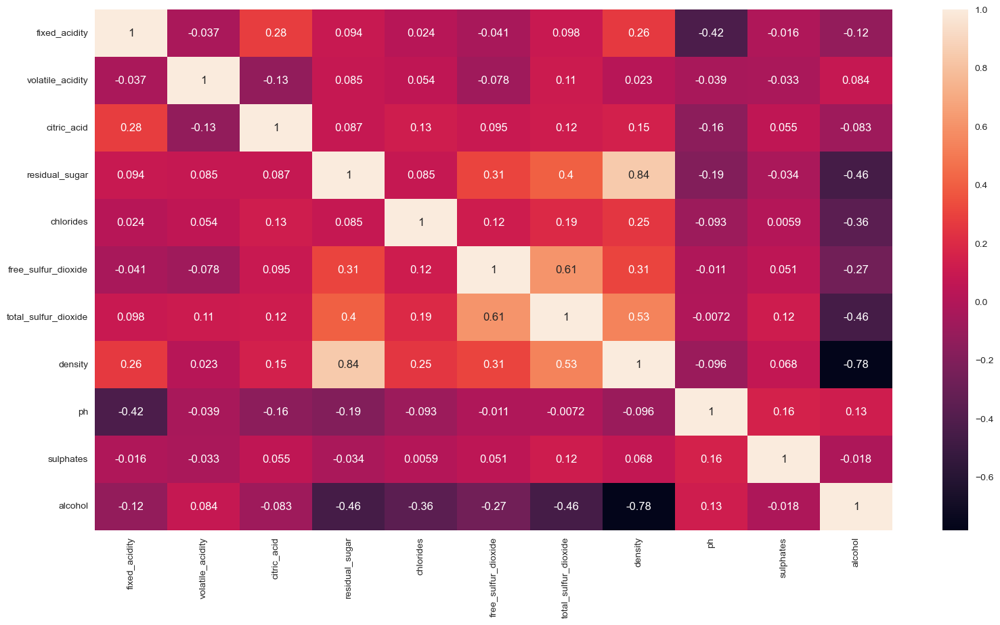

In [17]:
# ploting heatmap
plt.figure(figsize=[19,10], facecolor='white')
sns.heatmap(wine_df_x.corr(), annot=True)

### Code for finding correlated features that are above given value

In [18]:
for a in range(len(wine_df_x.corr().columns)):
    for b in range(a):
        if abs(wine_df_x.corr().iloc[a,b]) > 0.8:
            feature_name = wine_df_x.corr().columns[a]
            print(feature_name)

density


### Check only those high correlated feature 

In [19]:
wine_df_x[['residual_sugar','density']].corr()

,residual_sugar,density
residual_sugar,1.00000,0.84472
density,0.84472,1.00000


Text(0, 0.5, 'Density')

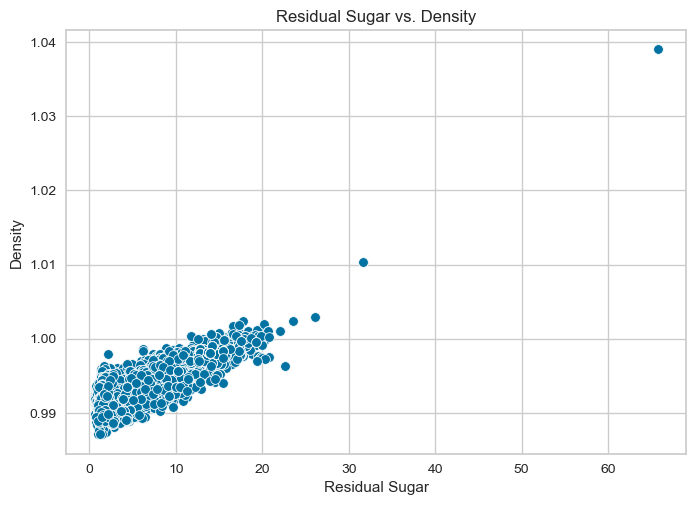

In [20]:
ax = sns.scatterplot(x="residual_sugar", y="density", data=wine_df_x);
ax.set_title("Residual Sugar vs. Density")
ax.set_xlabel("Residual Sugar");
ax.set_ylabel("Density")

## Data Scaling

### Custome method for ploting boxplot

In [21]:
# https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.boxplot.html
def boxplot_dataframre(df):
    fig = plt.figure(figsize = (20,10))
    df.boxplot(column=[name for name in list(df)], grid=False)
    plt.grid(False)
    plt.show()

### Boxplot the datatset before scaling

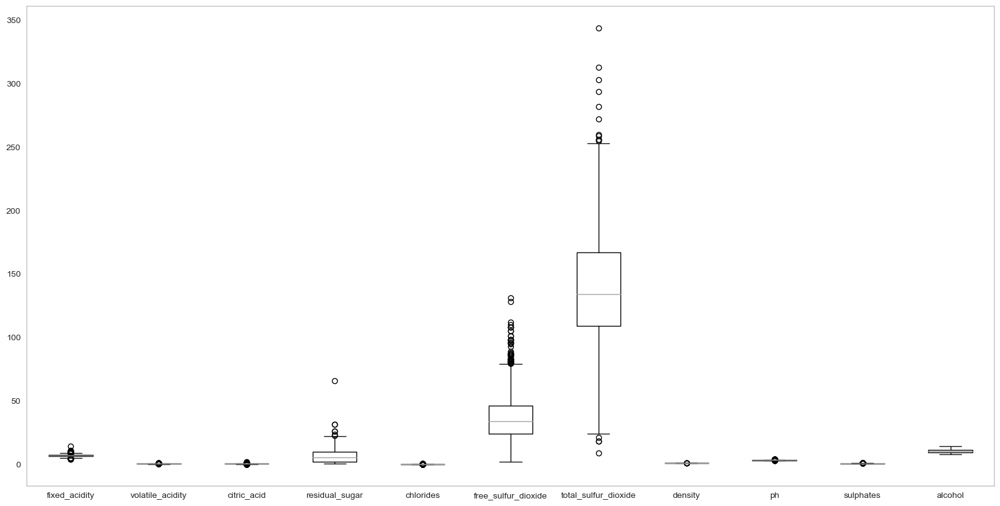

In [22]:
boxplot_dataframre(wine_df_x) # visualize dataframe before any scaling

### Scale using cutome min-max scaller

In [23]:
# scaling the data from 0 to 10
data = wine_df_x.copy()

data = (data - data.min()) # mainly for convert minmum value of each column to 0 
data = (data / (data.max() - data.min())) # then devide it by range, and this will re-sacle everything 0 to 1
data = data * 9 # re-sacle everything 0 to 9
min_max_scaled_wine_df_x = data + 1 # re-sacle everything 1 to 10

min_max_scaled_wine_df_x.head() # view sacled dat

,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide,total_sulfur_dioxide,density,ph,sulphates,alcohol
0,4.721154,2.932203,3.222892,1.117331,1.640950,1.627907,2.450746,1.640254,3.209091,4.558140,6.806452
1,5.153846,2.525424,3.168675,1.496933,1.694362,2.046512,3.686567,2.316946,4.436364,4.244186,3.467742
2,4.548077,2.016949,3.006024,1.082822,1.827893,1.976744,2.773134,1.848467,4.763636,5.290698,5.064516
3,4.894231,4.457627,4.361446,3.574387,1.827893,3.720930,5.379104,3.271255,3.127273,5.709302,3.467742
4,3.336538,3.338983,1.759036,1.952454,1.934718,3.232558,4.331343,2.455755,5.090909,3.930233,3.177419


### Check the inbuilt min-max scaler from sklearn

In [24]:
# Transform features by scaling each feature to a given range.
# https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html
#min_max_scaler = preprocessing.MinMaxScaler()
#min_max_scaled_dataset = min_max_scaler.fit_transform(wine_df_x)
#min_max_scaled_wine_df_x = pd.DataFrame(min_max_scaled_dataset, columns = [name for name in list(wine_df_x)])

#min_max_scaled_wine_df_x.head()

### After the min-max scalling process

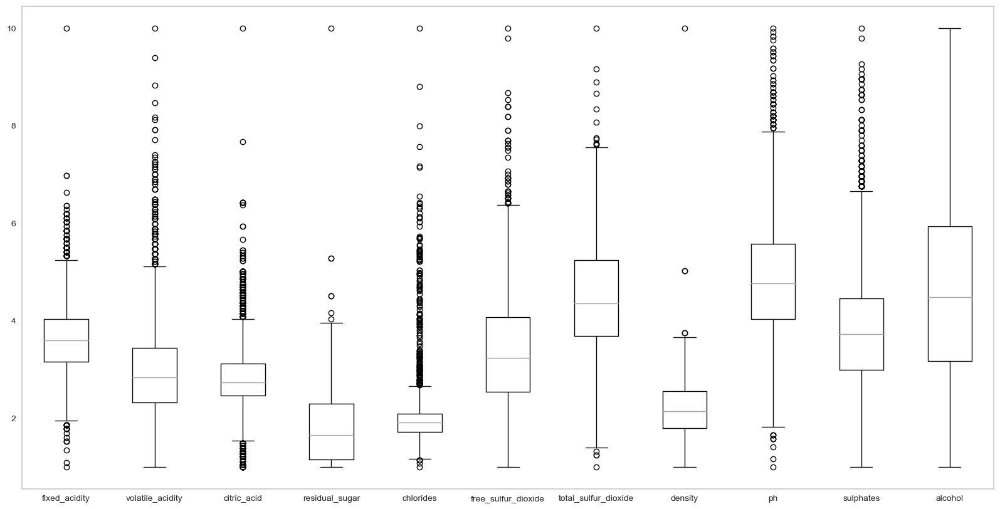

In [25]:
boxplot_dataframre(min_max_scaled_wine_df_x)  # visualize the dataframe after inbuilt min-max scaling

### Standardization

In [26]:
# standardize features by removing the mean and scaling to unit variance.
# https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html
standrd_scaler = preprocessing.StandardScaler()
scaled_dataset = standrd_scaler.fit_transform(min_max_scaled_wine_df_x)
scaled_wine_df_x = pd.DataFrame(scaled_dataset, columns = [name for name in list(min_max_scaled_wine_df_x)])
scaled_wine_df_x.head()

,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide,total_sulfur_dioxide,density,ph,sulphates,alcohol
0,1.524059,-0.046488,0.627192,-0.983276,-0.585763,-1.527398,-1.823220,-1.070283,-1.319699,0.610575,1.193708
1,2.129574,-0.466952,0.543381,-0.442997,-0.492829,-1.155574,-0.715322,0.226894,-0.321586,0.347351,-0.668600
2,1.281853,-0.992533,0.291949,-1.032392,-0.260493,-1.217545,-1.534203,-0.671152,-0.055422,1.224765,0.222069
3,1.766265,1.530255,2.387216,2.513801,-0.260493,0.331720,0.802017,2.056247,-1.386239,1.575730,-0.668600
4,-0.413589,0.373977,-1.635696,0.205337,-0.074624,-0.102074,-0.137288,0.492982,0.210741,0.084127,-0.830540


### After the standardization process

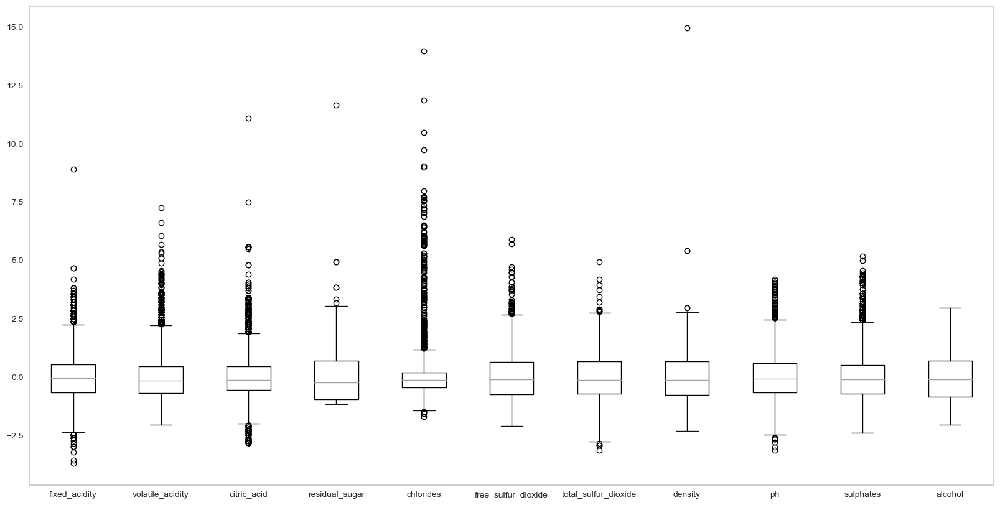

In [27]:
boxplot_dataframre(scaled_wine_df_x) # visualize the dataframe after standardized scaling

## Treating the Outliers

### Custome outlier detection method

In [28]:
# outlier detection function
def find_outliers(df, ft):
    Q1 = df[ft].quantile(0.25)
    Q3 = df[ft].quantile(0.75)
    IQR = Q3 - Q1
    
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    ls = df.index[(df[ft] < lower_bound) | (df[ft] > upper_bound)]
    
    return ls

### Finding outliers by passing each features to the above method

In [29]:
# find outliers and store into an array
index_list = []
for feature in [name for name in list(scaled_wine_df_x)]:
    index_list.extend(find_outliers(scaled_wine_df_x, feature))
    
print("Number of Outliers Found : ", len(index_list))

Number of Outliers Found :  989


### Outliers removal function

In [30]:
def remove_outliers(df, ls):
    ls = sorted(set(ls))
    df = df.drop(ls)
    return df

### After outliers removal process 

In [31]:
scaled_cleaned_wine_df_x = remove_outliers(scaled_wine_df_x, index_list)

print("After removing outliers : ", scaled_cleaned_wine_df_x.shape)

After removing outliers :  (3887, 11)


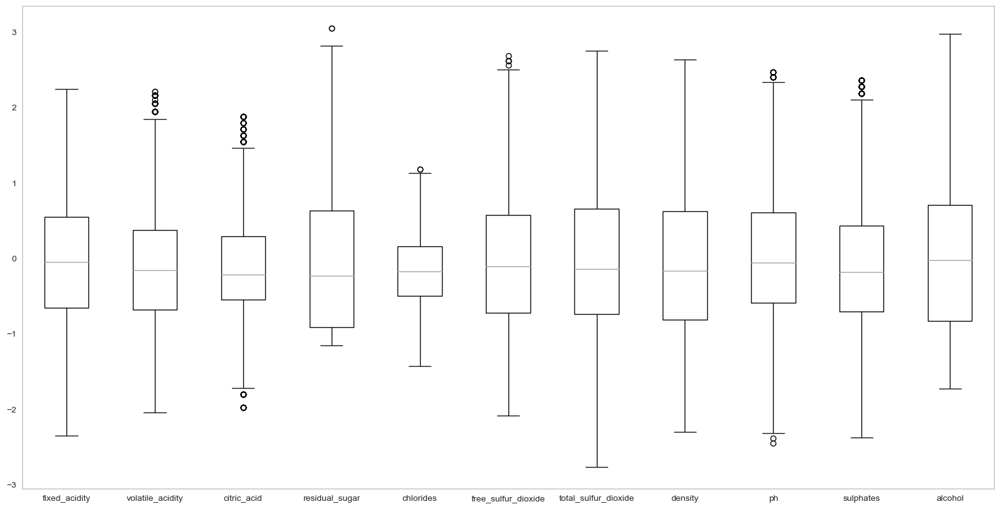

In [32]:
boxplot_dataframre(scaled_cleaned_wine_df_x) # visualize the dataframe after outliers remoeval

### Custom method to plotting pairplot

In [39]:
# we can see how the data points of each feature and how the relationsjip between each features
# https://seaborn.pydata.org/generated/seaborn.pairplot.html
def pairplot_dataframe(df, facet_height, hue_coluumn):
    sns.set()
    
    if hue_coluumn == "":
        sns.pairplot(df, height = facet_height)
    else:
        sns.pairplot(df, height = facet_height, hue = hue_coluumn)
        
    plt.show()

In [34]:
def half_pairplot_dataframe(df, facet_height, hue_coluumn):
    sns.set()
    sns.pairplot(df, height = facet_height, hue = hue_coluumn, corner=True)
    plt.show()

### Pair-plot raw dataset to compare the pre-processing effects visualy

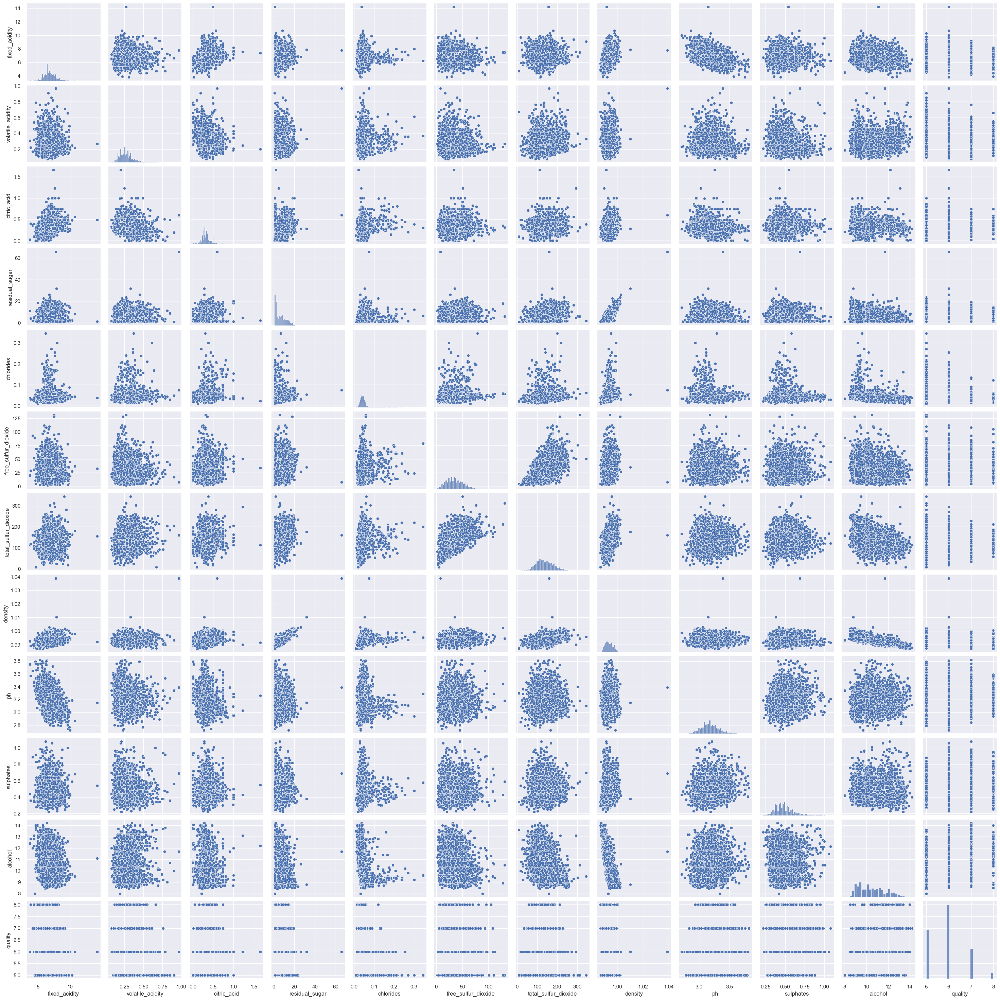

In [43]:
pairplot_dataframe(raw_wine_df, 2.5, "")

### Pair-plot after scalling processes

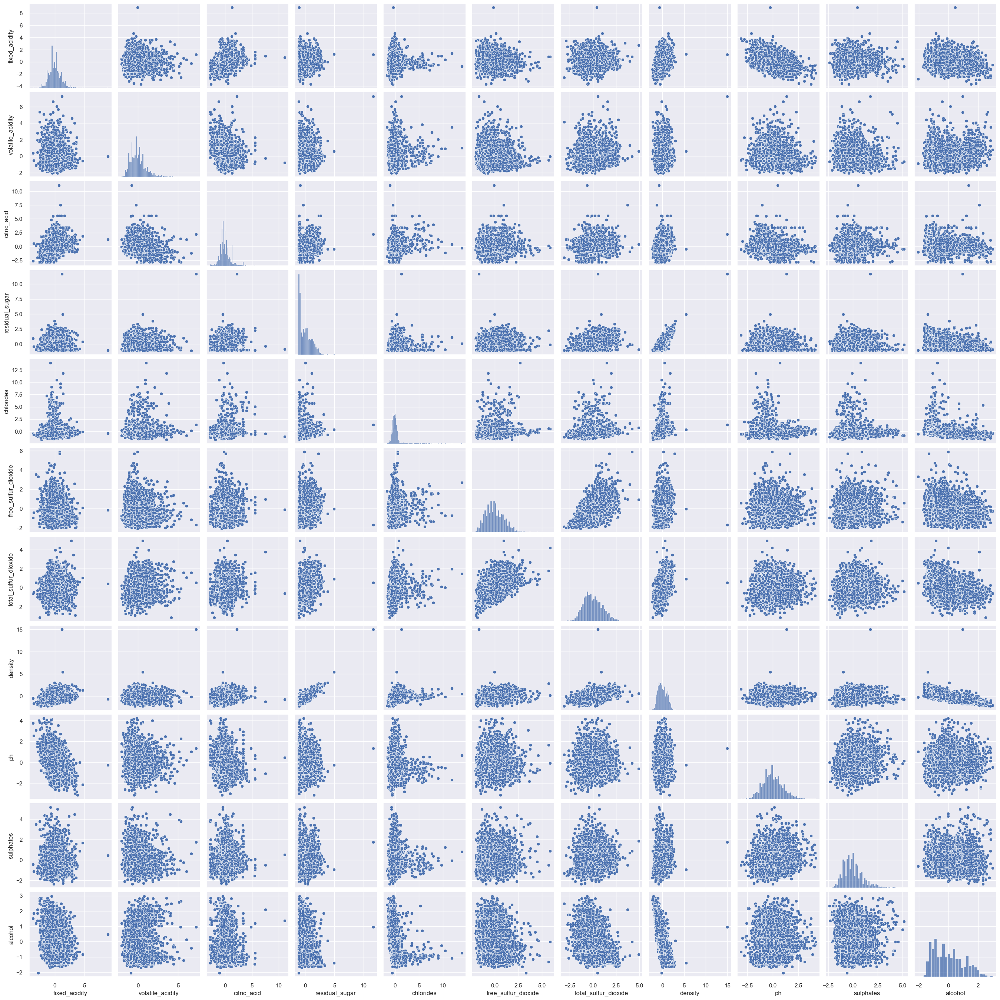

In [41]:
pairplot_dataframe(scaled_wine_df_x, 2.5, "")

### Pair-plot after outliers removal process

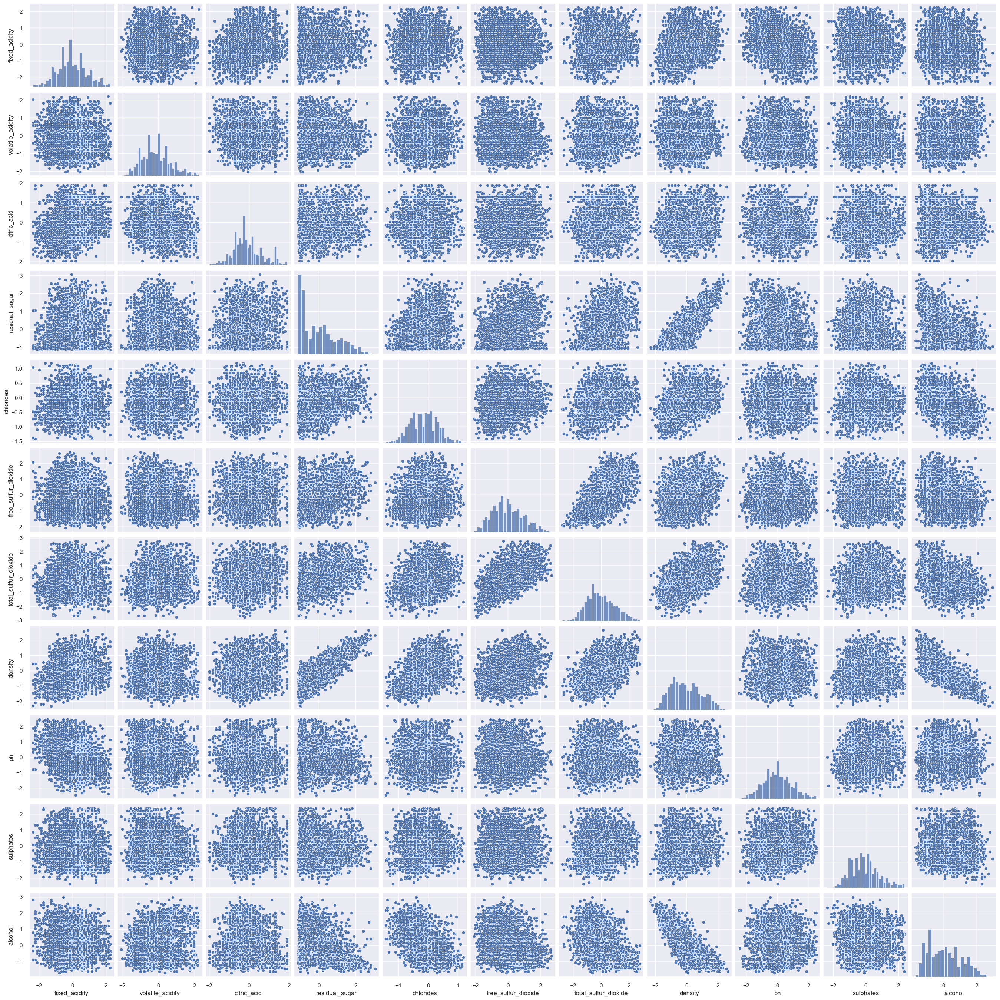

In [42]:
pairplot_dataframe(scaled_cleaned_wine_df_x, 2.5, "")

## Define the Number of Clusters

## Manual Method

In [44]:
print('K value as per the dataset : ', len(raw_wine_df['quality'].unique()))

K value as per the dataset :  4


In [45]:
df_grouped_by_quality = raw_wine_df.groupby(['quality'], sort=False).size().reset_index(name='Count')
df_grouped_by_quality

,quality,Count
0,5,1457
1,6,2198
2,7,880
3,8,175


## The Elbow Method

### Code for calculating WSS values

In [46]:
wss=[]
for i in range(1,10):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(scaled_cleaned_wine_df_x)
    wss.append(kmeans.inertia_)

C:\Users\sadde\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1036: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=16.
  warnings.warn(


### Plot the elbow 

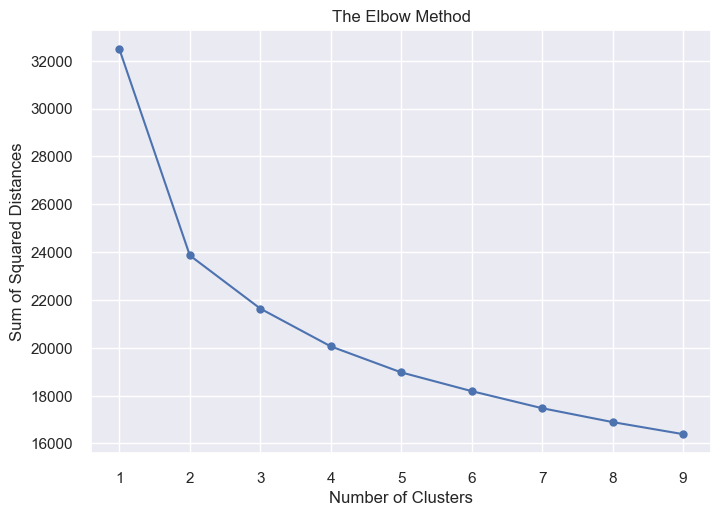

In [47]:
plt.plot(range(1,10), wss, 'o-')
plt.title('The Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('Sum of Squared Distances')
plt.show()

### Draw the line on elbow point

C:\Users\sadde\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1036: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=16.
  warnings.warn(


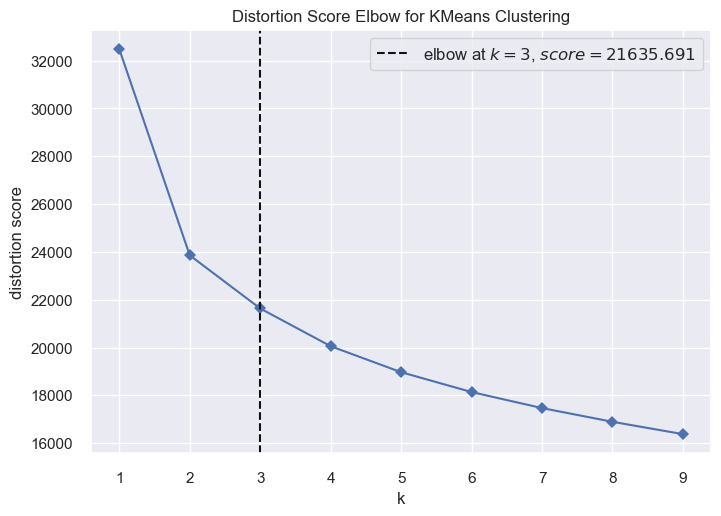

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [48]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,10), timings = False)
visualizer.fit(scaled_cleaned_wine_df_x)
visualizer.show()

## Silhouette Method

### Caculate silhouette coefficients

In [49]:
silhouette_coefficients = []
for i in range(2,10):
    kmeans = KMeans(n_clusters=i, max_iter=100)
    kmeans.fit(scaled_cleaned_wine_df_x)
    sil_score = silhouette_score(scaled_cleaned_wine_df_x, kmeans.labels_)
    print("For cluster: {}, the silhouette score is: {}".format(i, sil_score))
    silhouette_coefficients.append(sil_score)

For cluster: 2, the silhouette score is: 0.23998178310469265
For cluster: 3, the silhouette score is: 0.16846323282162565
For cluster: 4, the silhouette score is: 0.15017129713632793
For cluster: 5, the silhouette score is: 0.12630126362493724
For cluster: 6, the silhouette score is: 0.12254478134624744
For cluster: 7, the silhouette score is: 0.11408035204546355
For cluster: 8, the silhouette score is: 0.11701837806814688
For cluster: 9, the silhouette score is: 0.11364856548133656


### Plot silhouette coefficients

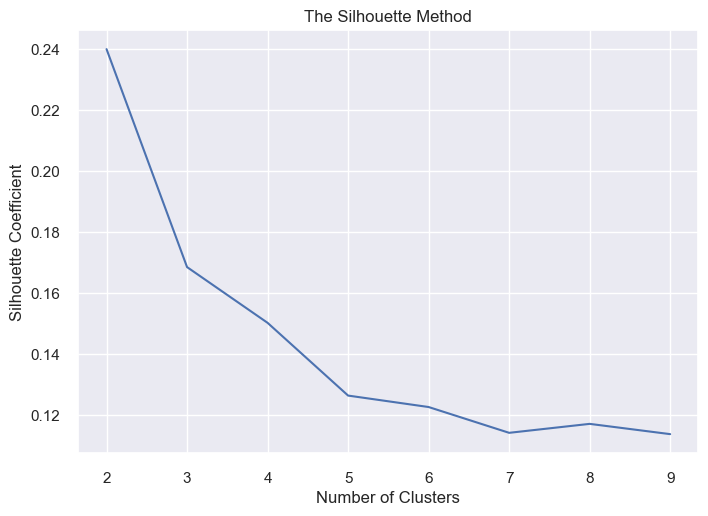

In [50]:
plt.plot(range(2,10), silhouette_coefficients)
plt.xticks(range(2,10))
plt.title('The Silhouette Method')
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()

### NbClust in R Method

In [51]:
# NbClust method tried with R not with python

### Data points before clustering

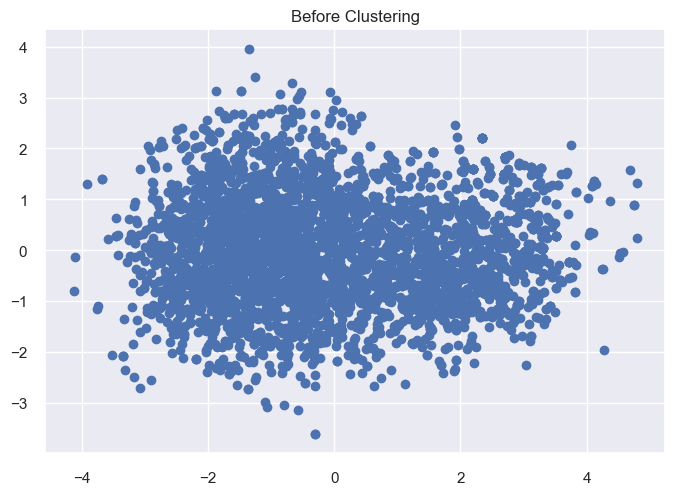

In [52]:
pca = PCA(n_components = 2)
data_2d = pca.fit_transform(scaled_cleaned_wine_df_x)

plt.title('Before Clustering')
plt.scatter(x = data_2d[:, 0], y = data_2d[:, 1])
plt.show()

### Note: Custom method for clustering will explain using separate file

### Pair-plot of each feature using qulity clusters

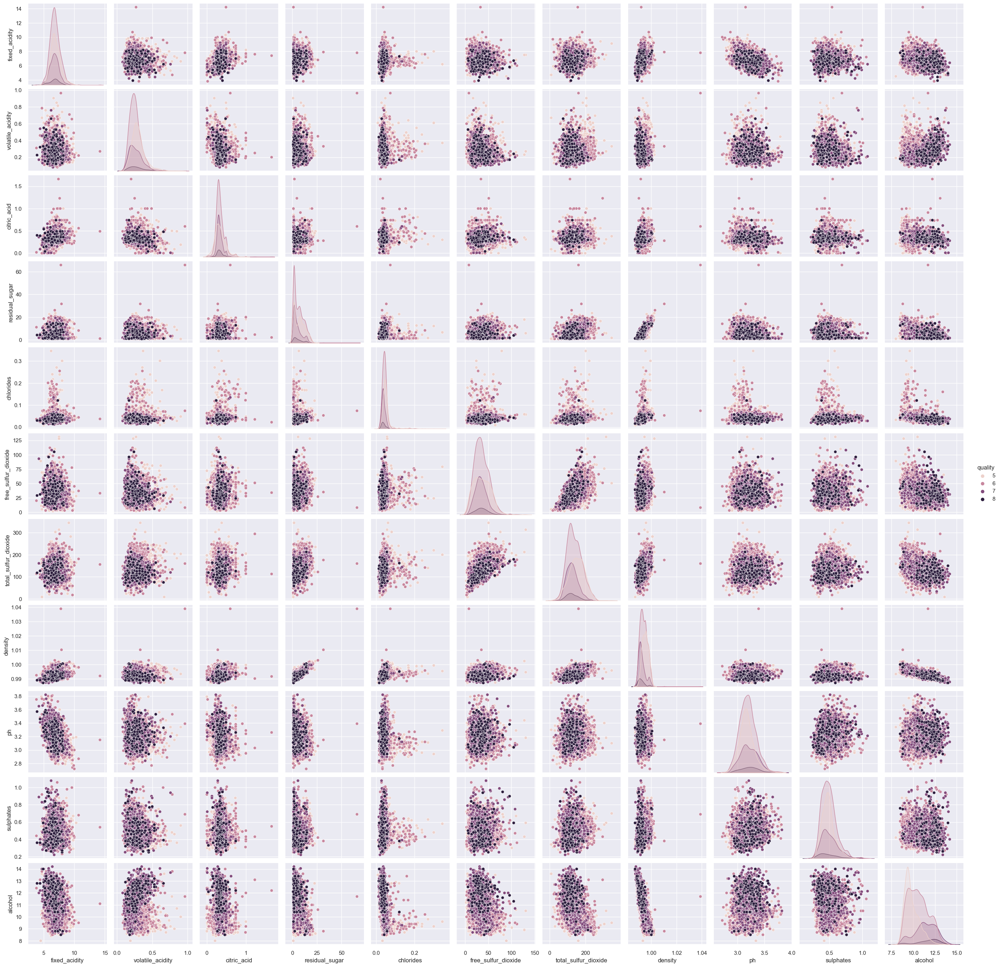

In [53]:
pairplot_dataframe(raw_wine_df, 2.5, "quality")

### K-means algorithm methods

In [54]:
def run_kmeans(k, df):
    kmeans = KMeans(n_clusters = k, max_iter=100)
    label = kmeans.fit_predict(df)
    unique_labels = np.unique(label)
    centroids = kmeans.cluster_centers_
    
    return kmeans, label

In [76]:
def show_clustered_datapoints(pca_data, kmeans, label, show_centriods):
    
    centroids = kmeans.cluster_centers_
    centroids_x = centroids[:,0]
    centroids_y = centroids[:,1]
    
    unique_labels = np.unique(label)
    
    for i in unique_labels:
        plt.scatter(pca_data[label == i, 0], pca_data[label == i, 1], label = i, s = 20)
        
        if show_centriods:
            plt.scatter(centroids_x, centroids_y, marker = "o", s = 20, linewidths = 2, zorder = 1, color="r")

    plt.legend()
    title = 'Wine Clusters after ' + str(kmeans.n_iter_) + ' Iterations'
    plt.title(title)
    plt.show()

In [56]:
def show_kmeans_result(kmeans):
    print("The lowest SSE value:", kmeans.inertia_)
    print()
    print("Centriods:", kmeans.cluster_centers_)
    print()
    print("Shape of centroids:", kmeans.cluster_centers_.shape)
    print()
    print("Labels predicted by K-Means:", kmeans.labels_)
    print()
    print("Iterations:", kmeans.n_iter_)

### K-means algorithm with 2 number of clusters

In [57]:
kmeans_2, labels_2 = run_kmeans(2, scaled_cleaned_wine_df_x)
show_kmeans_result(kmeans_2)

The lowest SSE value: 23858.2219287805

Centriods: [[ 0.08226812 -0.06526345 -0.0213295   0.89617102  0.09782188  0.56217881
   0.77008689  0.93236093 -0.164198   -0.00331994 -0.76769574]
 [-0.12357346 -0.14853154 -0.14047167 -0.56870203 -0.31340115 -0.40340114
  -0.52491682 -0.66326504  0.0997747  -0.11656035  0.56066511]]

Shape of centroids: (2, 11)

Labels predicted by K-Means: [1 1 1 ... 1 1 1]

Iterations: 8


### Method to mark assignments to the nearest cluster

In [63]:
def add_centroid_labels(df, labels):
    # added cluster_no column to see the data point assignments to the nearest cluster
    final_wine_df_x = df.copy()
    final_wine_df_x["cluster_no"] = labels
    print(final_wine_df_x.head())
    
    return final_wine_df_x

### Mark centroid labels with k values as 2

In [64]:
lablized_wine_df_x_2 = add_centroid_labels(scaled_cleaned_wine_df_x, labels_2)

   fixed_acidity  volatile_acidity  citric_acid  residual_sugar  chlorides  \
0       1.524059         -0.046488     0.627192       -0.983276  -0.585763   
1       2.129574         -0.466952     0.543381       -0.442997  -0.492829   
2       1.281853         -0.992533     0.291949       -1.032392  -0.260493   
4      -0.413589          0.373977    -1.635696        0.205337  -0.074624   
6      -1.261310         -0.046488    -1.132832        1.669001  -0.074624   

   free_sulfur_dioxide  total_sulfur_dioxide   density        ph  sulphates  \
0            -1.527398             -1.823220 -1.070283 -1.319699   0.610575   
1            -1.155574             -0.715322  0.226894 -0.321586   0.347351   
2            -1.217545             -1.534203 -0.671152 -0.055422   1.224765   
4            -0.102074             -0.137288  0.492982  0.210741   0.084127   
6            -0.845721              0.970610  0.725809  1.208854  -1.056510   

    alcohol  cluster_no  
0  1.193708           1  
1 -0

In [65]:
# clusters and no of data points that they have acquired
lablized_wine_df_x_2.cluster_no.value_counts()

1    2395
0    1492
Name: cluster_no, dtype: int64

### Calculate TSS, SSW and SSB

In [66]:
def calulate_result_ratios(kmeans, df):
    TSS = sum(np.sum((df-df.mean(0))**2))
    SSW = kmeans.inertia_
    SSB = TSS - SSW

    # Within-cluster sum of squares
    print('SSW:', SSW)
    # Total within-cluster sum of squares 
    print('TSS:', TSS)
    # Between-cluster sum of squares
    print('SSB:', SSB)
    
    return SSW, TSS, SSB

### Calculate TSS, SSW and SSB k values as 2

In [73]:
SSW_2, TSS_2, SSB_2 = calulate_result_ratios(kmeans_2, scaled_cleaned_wine_df_x)

SSW: 23858.2219287805
TSS: 32482.138906419255
SSB: 8623.916977638757


In [135]:
silhouette_avg = silhouette_score(scaled_cleaned_wine_df_x, kmeans_2.labels_)
silhouette_avg

0.23998178310469265

### Pair-plot all features with 2 clusters

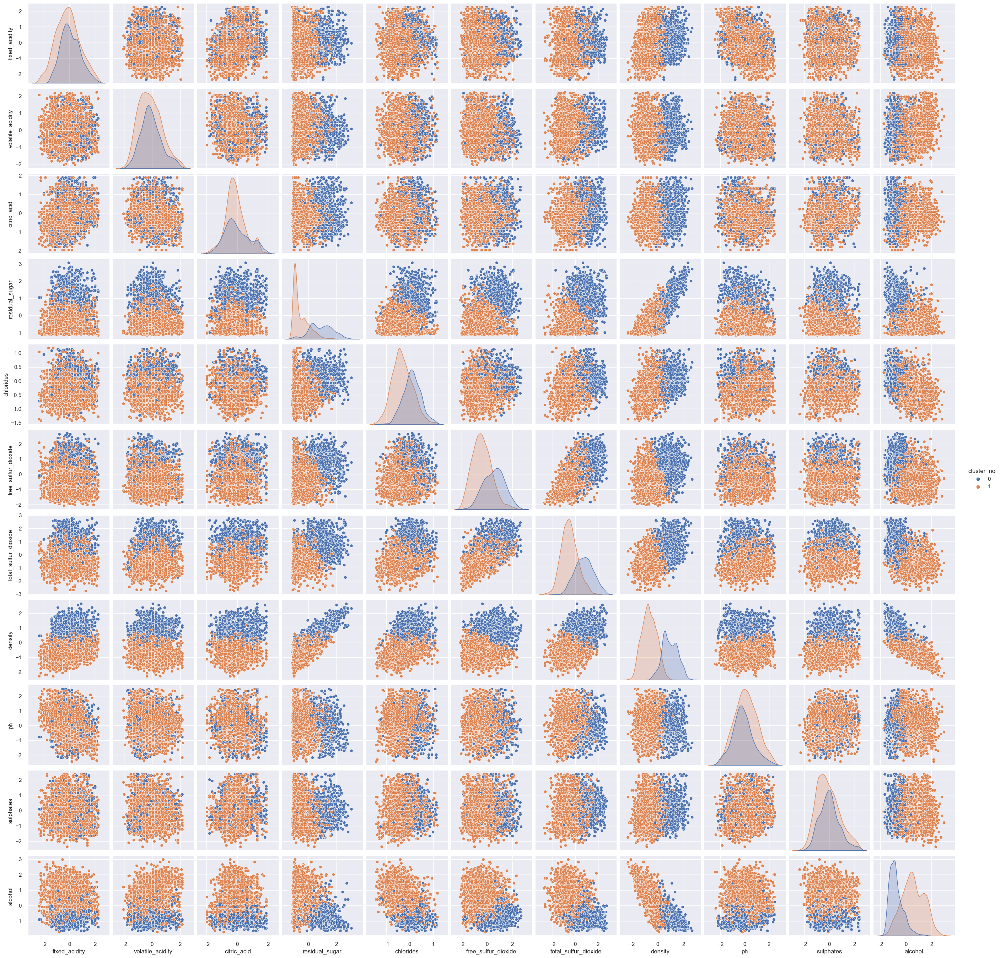

In [68]:
pairplot_dataframe(lablized_wine_df_x_2, 2.5, "cluster_no")

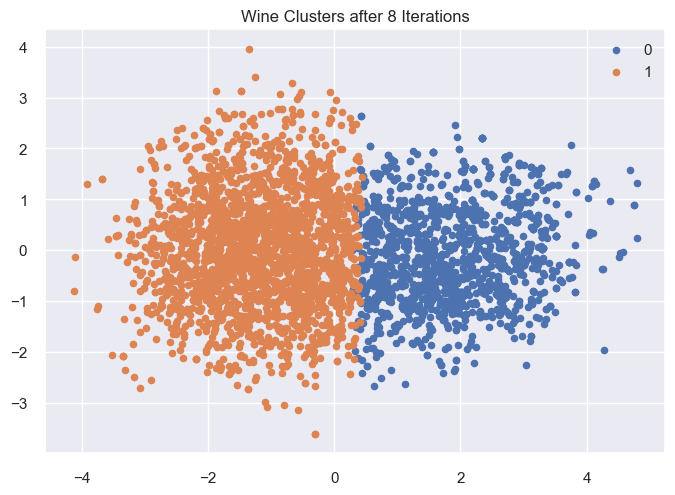

In [215]:
pca_view_only = PCA(n_components = 2)
scores_2 = pca_view_only.fit_transform(scaled_cleaned_wine_df_x)

show_clustered_datapoints(scores_2, kmeans_2, labels_2, False)

### K-means algorithm with 3 number of clusters

In [81]:
kmeans_3, labels_3 = run_kmeans(3, scaled_cleaned_wine_df_x)
show_kmeans_result(kmeans_3)

The lowest SSE value: 21635.69109748826

Centriods: [[-6.97696222e-01 -2.37588835e-01 -2.77158591e-01 -6.00483585e-01
  -2.88633104e-01 -2.39995683e-01 -3.82885141e-01 -6.29801816e-01
   7.70109905e-01  1.08765142e-01  4.51740604e-01]
 [ 8.14060421e-02 -7.12666391e-02 -1.45885717e-02  9.36286617e-01
   1.08756316e-01  5.75322991e-01  7.78687490e-01  9.72188156e-01
  -1.84002436e-01 -1.20247900e-03 -8.10282924e-01]
 [ 4.78974304e-01 -4.51499884e-02 -9.06276934e-04 -4.95024988e-01
  -3.26912434e-01 -5.28541601e-01 -6.03084786e-01 -6.48374366e-01
  -5.80920315e-01 -3.43485627e-01  6.42452063e-01]]

Shape of centroids: (3, 11)

Labels predicted by K-Means: [2 2 2 ... 0 0 0]

Iterations: 40


### Mark centroid labels with k values as 3

In [82]:
lablized_wine_df_x_3 = add_centroid_labels(scaled_cleaned_wine_df_x, labels_3)

   fixed_acidity  volatile_acidity  citric_acid  residual_sugar  chlorides  \
0       1.524059         -0.046488     0.627192       -0.983276  -0.585763   
1       2.129574         -0.466952     0.543381       -0.442997  -0.492829   
2       1.281853         -0.992533     0.291949       -1.032392  -0.260493   
4      -0.413589          0.373977    -1.635696        0.205337  -0.074624   
6      -1.261310         -0.046488    -1.132832        1.669001  -0.074624   

   free_sulfur_dioxide  total_sulfur_dioxide   density        ph  sulphates  \
0            -1.527398             -1.823220 -1.070283 -1.319699   0.610575   
1            -1.155574             -0.715322  0.226894 -0.321586   0.347351   
2            -1.217545             -1.534203 -0.671152 -0.055422   1.224765   
4            -0.102074             -0.137288  0.492982  0.210741   0.084127   
6            -0.845721              0.970610  0.725809  1.208854  -1.056510   

    alcohol  cluster_no  
0  1.193708           2  
1 -0

In [83]:
# clusters and no of data points that they have acquired
lablized_wine_df_x_3.cluster_no.value_counts()

1    1419
0    1250
2    1218
Name: cluster_no, dtype: int64

### Calculate TSS, SSW and SSB k values as 3

In [85]:
calulate_result_ratios(kmeans_3, scaled_cleaned_wine_df_x)

SSW: 21635.69109748826
TSS: 32482.138906419255
SSB: 10846.447808930996


(21635.69109748826, 32482.138906419255, 10846.447808930996)

### Pair-plot all features with 3 clusters

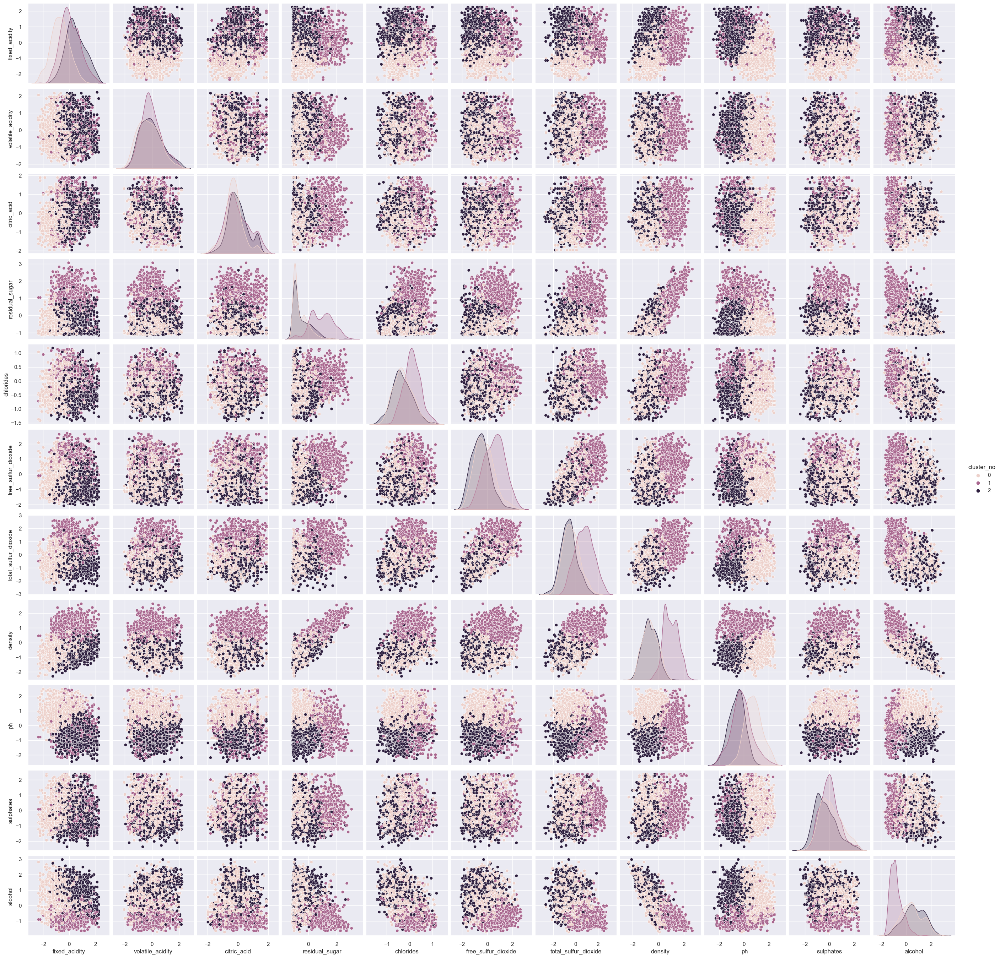

In [86]:
pairplot_dataframe(lablized_wine_df_x_3, 2.5, "cluster_no")

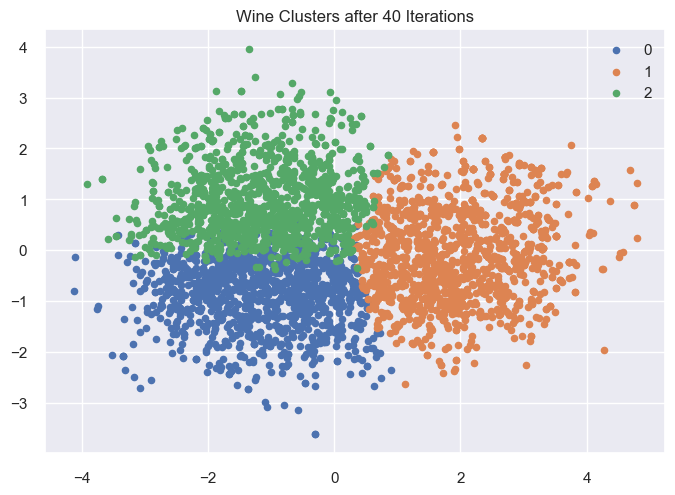

In [214]:
scores_3 = pca_view_only.fit_transform(scaled_cleaned_wine_df_x)

show_clustered_datapoints(scores_3, kmeans_3, labels_3, False)

### K-means algorithm with 4 number of clusters

In [87]:
kmeans_4, labels_4 = run_kmeans(4, scaled_cleaned_wine_df_x)
show_kmeans_result(kmeans_4)

The lowest SSE value: 20057.010225202368

Centriods: [[ 0.09095836 -0.02867138  0.00994239  1.07105959  0.11705813  0.62349245
   0.83031019  1.06388921 -0.24188719 -0.03130313 -0.85219263]
 [-0.62666276  0.23205689 -0.21714238 -0.58500135 -0.53180484 -0.42695131
  -0.79139833 -1.15705094  0.24501701 -0.27413138  1.34029991]
 [-0.48331652 -0.40278318 -0.29687201 -0.50040613 -0.10437864 -0.08140599
  -0.02864977 -0.21858977  0.74129234  0.25436618 -0.1259374 ]
 [ 0.72467393 -0.24474109  0.07634485 -0.45651627 -0.25040863 -0.5284682
  -0.52534937 -0.42756698 -0.64935574 -0.29008899  0.33485581]]

Shape of centroids: (4, 11)

Labels predicted by K-Means: [3 3 3 ... 1 1 1]

Iterations: 14


### Mark centroid labels with k values as 4

In [88]:
lablized_wine_df_x_4 = add_centroid_labels(scaled_cleaned_wine_df_x, labels_4)

   fixed_acidity  volatile_acidity  citric_acid  residual_sugar  chlorides  \
0       1.524059         -0.046488     0.627192       -0.983276  -0.585763   
1       2.129574         -0.466952     0.543381       -0.442997  -0.492829   
2       1.281853         -0.992533     0.291949       -1.032392  -0.260493   
4      -0.413589          0.373977    -1.635696        0.205337  -0.074624   
6      -1.261310         -0.046488    -1.132832        1.669001  -0.074624   

   free_sulfur_dioxide  total_sulfur_dioxide   density        ph  sulphates  \
0            -1.527398             -1.823220 -1.070283 -1.319699   0.610575   
1            -1.155574             -0.715322  0.226894 -0.321586   0.347351   
2            -1.217545             -1.534203 -0.671152 -0.055422   1.224765   
4            -0.102074             -0.137288  0.492982  0.210741   0.084127   
6            -0.845721              0.970610  0.725809  1.208854  -1.056510   

    alcohol  cluster_no  
0  1.193708           3  
1 -0

In [89]:
# clusters and no of data points that they have acquired
lablized_wine_df_x_4.cluster_no.value_counts()

0    1239
2     938
3     918
1     792
Name: cluster_no, dtype: int64

### Calculate TSS, SSW and SSB k values as 4

In [90]:
calulate_result_ratios(kmeans_4, scaled_cleaned_wine_df_x)

SSW: 20057.010225202368
TSS: 32482.138906419255
SSB: 12425.128681216887


(20057.010225202368, 32482.138906419255, 12425.128681216887)

### Pair-plot all features with 4 clusters

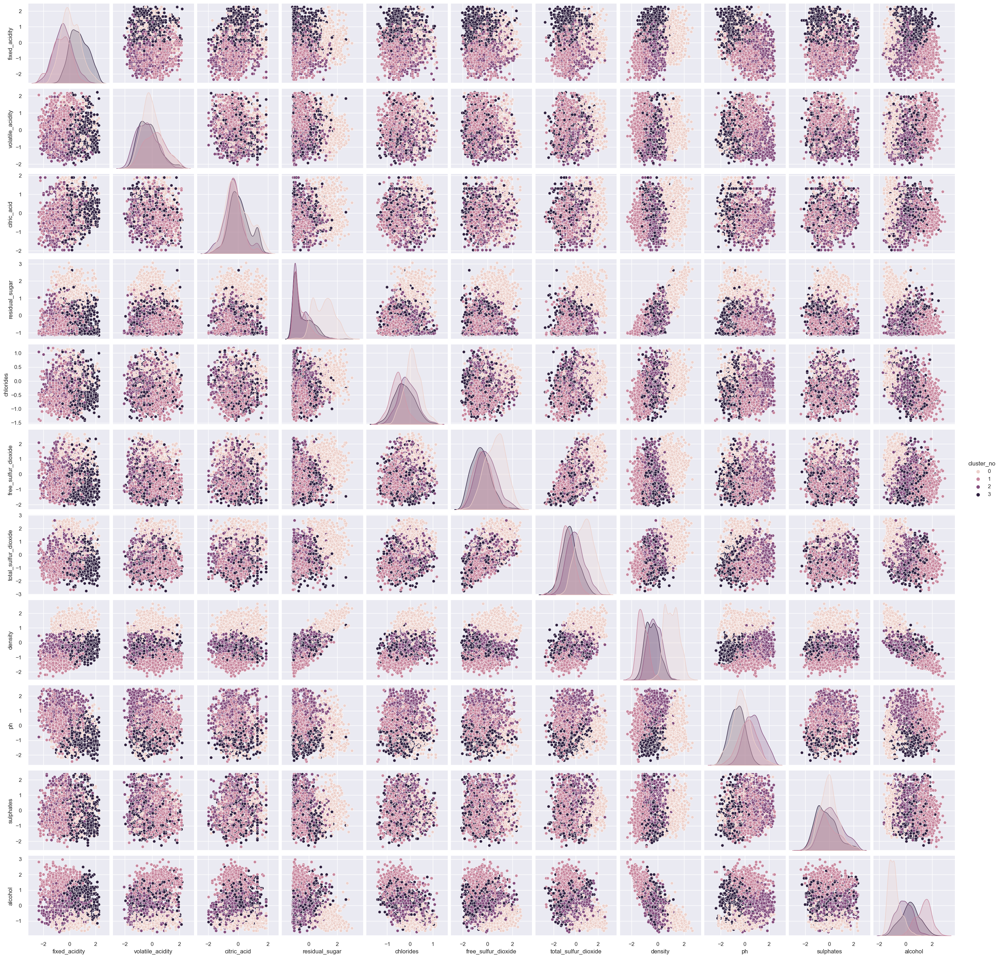

In [91]:
pairplot_dataframe(lablized_wine_df_x_4, 2.5, "cluster_no")

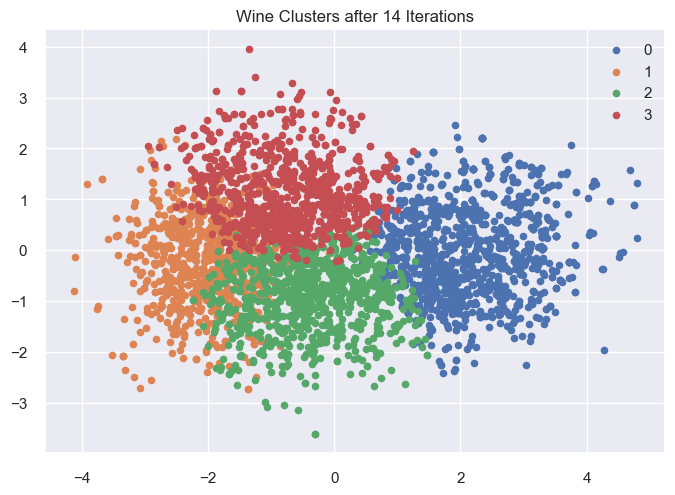

In [213]:
scores_4 = pca_view_only.fit_transform(scaled_cleaned_wine_df_x)

show_clustered_datapoints(scores_4, kmeans_4, labels_4, False)

## Evaluation of the Produced Outputs

In [97]:
def show_cluster_labels(df, class_column):
    # unique labels of each data points (clusters)
    labels = df[class_column].unique()
    return labels

In [98]:
def split_dataset(df, class_column):  
    features = [name for name in list(df)]
    
    y = df[class_column]
    X = df[features].copy()

    # split train and test sets as 70% and 30% respectively
    x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 0)
    print("Size of train sample", x_train.shape, type(x_train))
    print("Size of Test sample", x_test.shape, type(x_test))
    
    return  x_train, x_test, y_train, y_test

In [99]:
def create_confusion_matrix(df, class_column, cluster_labels):
    
    x_train, x_test, y_train, y_test = split_dataset(df, class_column)
    
    # Let's try to build a classifier and evaluate accuracy
    clf = SVC(kernel = 'linear').fit(x_train, y_train)
    clf.predict(x_train)
    y_pred = clf.predict(x_test)

    # creates a confusion matrix
    cm = confusion_matrix(y_test, y_pred) 

    # transform to data frame for easier plotting
    cm_df = pd.DataFrame(cm,
                         index = cluster_labels, 
                         columns = cluster_labels)

    plt.figure(figsize = (5.5, 4))
    sns.heatmap(cm_df, annot = True)
    plt.title('SVM Linear Kernel \n\nAccuracy:{0:.3f}'.format(accuracy_score(y_test, y_pred)))
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

### Accuracy of the initial wine dataset

In [102]:
cluster_labels_init = show_cluster_labels(raw_wine_df, 'quality')
cluster_labels_init

array([5, 6, 7, 8], dtype=int64)

Size of train sample (3297, 12) <class 'pandas.core.frame.DataFrame'>
Size of Test sample (1413, 12) <class 'pandas.core.frame.DataFrame'>


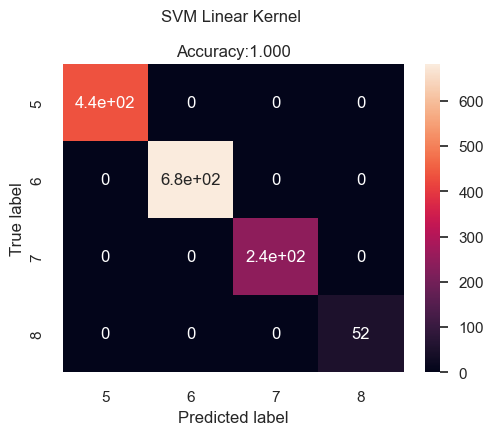

In [103]:
create_confusion_matrix(raw_wine_df, 'quality', cluster_labels_init)

### Accuracy of the processed 2 cluster dataset

In [104]:
cluster_labels_2 = show_cluster_labels(lablized_wine_df_x_2, 'cluster_no')
cluster_labels_2

array([1, 0])

Size of train sample (2720, 12) <class 'pandas.core.frame.DataFrame'>
Size of Test sample (1167, 12) <class 'pandas.core.frame.DataFrame'>


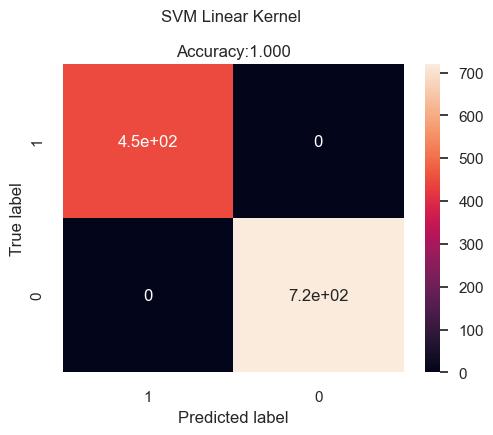

In [105]:
create_confusion_matrix(lablized_wine_df_x_2, 'cluster_no', cluster_labels_2)

### Accuracy of the processed 3 cluster dataset

In [106]:
cluster_labels_3 = show_cluster_labels(lablized_wine_df_x_3, 'cluster_no')
cluster_labels_3

array([2, 1, 0])

Size of train sample (2720, 12) <class 'pandas.core.frame.DataFrame'>
Size of Test sample (1167, 12) <class 'pandas.core.frame.DataFrame'>


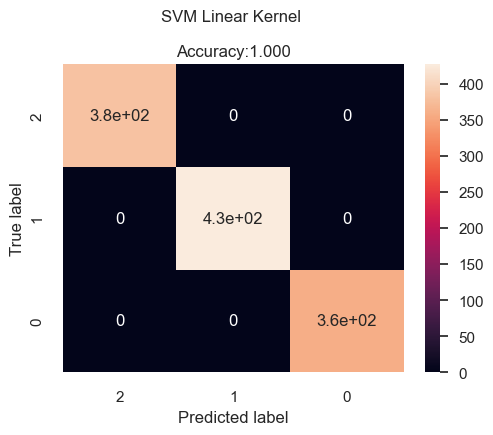

In [107]:
create_confusion_matrix(lablized_wine_df_x_3, 'cluster_no', cluster_labels_3)

### Accuracy of the processed 4 cluster dataset

In [108]:
cluster_labels_4 = show_cluster_labels(lablized_wine_df_x_4, 'cluster_no')
cluster_labels_4

array([3, 2, 0, 1])

Size of train sample (2720, 12) <class 'pandas.core.frame.DataFrame'>
Size of Test sample (1167, 12) <class 'pandas.core.frame.DataFrame'>


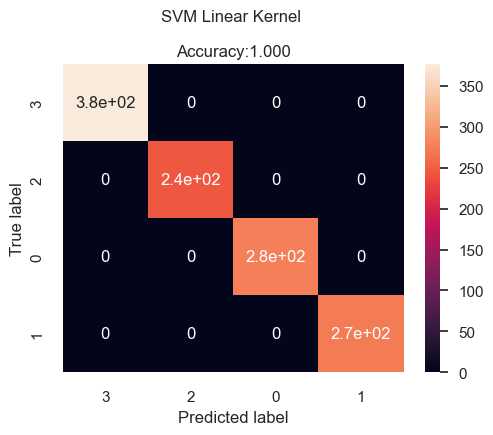

In [109]:
create_confusion_matrix(lablized_wine_df_x_4, 'cluster_no', cluster_labels_4)

## PCA on Wine Dataset

### Apply PCA

In [174]:
scaled_cleaned_wine_df_x

,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide,total_sulfur_dioxide,density,ph,sulphates,alcohol
0,1.524059,-0.046488,0.627192,-0.983276,-0.585763,-1.527398,-1.823220,-1.070283,-1.319699,0.610575,1.193708
1,2.129574,-0.466952,0.543381,-0.442997,-0.492829,-1.155574,-0.715322,0.226894,-0.321586,0.347351,-0.668600
2,1.281853,-0.992533,0.291949,-1.032392,-0.260493,-1.217545,-1.534203,-0.671152,-0.055422,1.224765,0.222069
4,-0.413589,0.373977,-1.635696,0.205337,-0.074624,-0.102074,-0.137288,0.492982,0.210741,0.084127,-0.830540
6,-1.261310,-0.046488,-1.132832,1.669001,-0.074624,-0.845721,0.970610,0.725809,1.208854,-1.056510,-0.263750
...,...,...,...,...,...,...,...,...,...,...,...
4703,-0.050280,-0.361836,-0.378536,-0.875220,-0.074624,-1.279516,-1.028424,-0.564717,0.277282,1.312506,-0.101811
4704,0.555235,-0.887417,-0.546157,1.462713,0.529450,0.579603,0.392576,1.347789,-1.652403,-0.705545,-1.397329
4705,-1.987928,0.268861,0.040517,-0.973453,-0.353427,-1.093604,-1.028424,-1.529285,2.473130,-0.091355,2.003407
4706,-0.534692,0.479093,-0.713779,-0.285825,0.436515,-0.473898,-0.016864,-0.767609,0.543445,0.084127,1.517587


In [110]:
pca = PCA()
pca.fit(scaled_cleaned_wine_df_x)

PCA()

In [111]:
pca.explained_variance_ratio_

array([0.36202034, 0.13841432, 0.10545526, 0.09865714, 0.08205869,
       0.06332698, 0.05775612, 0.04612753, 0.02916209, 0.01563925,
       0.00138228])

### Create a new dataset 

Text(0, 0.5, 'Cumulative Explained Variance')

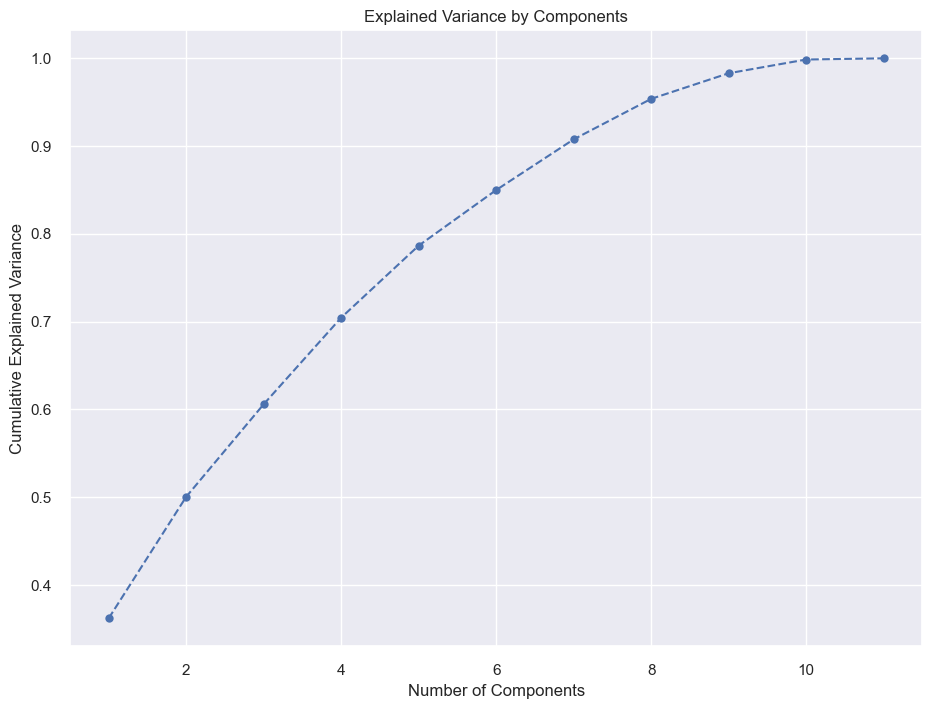

In [112]:
plt.figure(figsize=(11, 8))
plt.plot(range(1, 12), pca.explained_variance_ratio_.cumsum(), marker='o', linestyle='--')
plt.title('Explained Variance by Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')

In [203]:
pca_3 = PCA(n_components=3)
scores_pca = pca_3.fit_transform(scaled_cleaned_wine_df_x)
scores_pca

array([[-2.41405112,  2.39871479,  0.41032001],
       [-0.08304127,  1.84484301, -0.17933914],
       [-1.64824864,  1.06649561, -0.15282386],
       ...,
       [-3.31357283, -2.35983118, -0.70319569],
       [-1.3437442 , -0.71298704,  0.17447241],
       [-2.55639761, -0.97273707, -0.10877186]])

In [180]:
print('Size of wine dataset before PCA :', scaled_cleaned_wine_df_x.shape)

Size of wine dataset before PCA : (3887, 11)


In [181]:
print('Size of wine dataset after PCA :', scores_pca.shape)

Size of wine dataset after PCA : (3887, 3)


### Perform k-means on PCA dataset

In [190]:
kmeans_pca, labels_pca = run_kmeans(2, scores_pca)
show_kmeans_result(kmeans_pca)

The lowest SSE value: 11082.503210129442

Centriods: [[ 1.85600085 -0.05642683 -0.02073883]
 [-1.19056811  0.03619609  0.01330333]]

Shape of centroids: (2, 3)

Labels predicted by K-Means: [1 1 1 ... 1 1 1]

Iterations: 7


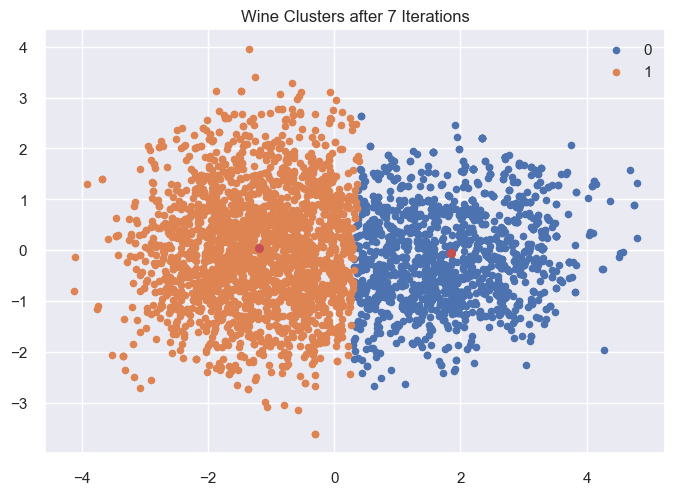

In [202]:
show_clustered_datapoints(scores_pca, kmeans_pca, labels_pca, True)

## K-Means clustering result comparison

In [192]:
scores_pca_df = pd.DataFrame(scores_pca, columns = ['PC_1','PC_2','PC_3'])

In [193]:
scores_pca_df

,PC_1,PC_2,PC_3
0,-2.414051,2.398715,0.410320
1,-0.083041,1.844843,-0.179339
2,-1.648249,1.066496,-0.152824
3,0.612576,-0.527917,-1.066150
4,1.156760,-1.206361,-1.820259
...,...,...,...
3882,-1.350742,-0.127274,-0.694048
3883,2.683903,1.500557,-0.588848
3884,-3.313573,-2.359831,-0.703196
3885,-1.343744,-0.712987,0.174472


### Calculate TSS, SSW and SSB k values as 2 with PCA dataset

In [200]:
SSW_pca, TSS_pca, SSB_pca = calulate_result_ratios(kmeans_pca, scores_pca_df)

SSW: 11082.503210129442
TSS: 19680.600664349015
SSB: 8598.097454219573


### Calculate average silhouette score

In [206]:
silhouette_avg_pca = silhouette_score(scores_pca_df, kmeans_pca.labels_)
silhouette_avg_pca

0.38034636203489747

### Compare previous winner case with PCA cased case

In [201]:
print('PCA Based, Percentage of Variance :', (SSB_pca / TSS_pca) * 100) 

PCA Based, Percentage of Variance : 43.68818615274706


In [204]:
print('Previous Winner Case, Percentage of Variance :', (SSB_2 / TSS_2) * 100) 

Previous Winner Case, Percentage of Variance : 26.549720147691573
